#Importing necessary libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import folium
from ipywidgets import interact
import warnings
warnings.filterwarnings('ignore')

#Loading datasets

In [2]:
cases_df = pd.read_csv('/content/WHO-COVID-19-global-table-data.csv',encoding='latin1')
vacc_df = pd.read_csv('/content/vaccination-data.csv',encoding='latin1')
loc_df = pd.read_csv('/content/location.csv',encoding='latin1')

###Initial Exploration

In [3]:
cases_df.head()

,Name,WHO Region,Cases - cumulative total,Cases - cumulative total per 100000 population,Cases - newly reported in last 7 days,Cases - newly reported in last 7 days per 100000 population,Cases - newly reported in last 24 hours,Deaths - cumulative total,Deaths - cumulative total per 100000 population,Deaths - newly reported in last 7 days,Deaths - newly reported in last 7 days per 100000 population,Deaths - newly reported in last 24 hours
0,Afghanistan,Eastern Mediterranean,235214.0,604.0,NaN,NaN,NaN,7998,21.0,NaN,NaN,NaN
1,Albania,Europe,337196.0,11717.0,0.0,NaN,0.0,3608,125.0,0.0,NaN,0.0
2,Algeria,Africa,272175.0,621.0,NaN,NaN,NaN,6881,16.0,NaN,NaN,NaN
3,American Samoa,Western Pacific,8359.0,15144.0,NaN,NaN,NaN,34,62.0,NaN,NaN,NaN
4,Andorra,Europe,48015.0,62143.0,NaN,NaN,NaN,159,206.0,NaN,NaN,NaN


In [4]:
vacc_df.head()

,COUNTRY,ISO3,WHO_REGION,DATA_SOURCE,DATE_UPDATED,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_VACCINATED_1PLUS_DOSE_PER100,PERSONS_LAST_DOSE,PERSONS_LAST_DOSE_PER100,VACCINES_USED,FIRST_VACCINE_DATE,NUMBER_VACCINES_TYPES_USED,PERSONS_BOOSTER_ADD_DOSE,PERSONS_BOOSTER_ADD_DOSE_PER100
0,Afghanistan,AFG,EMRO,REPORTING,31-12-2023,23000000.0,19200000.0,59.0,49.0,18400000.0,47.0,NaN,22-02-2021,NaN,2729940.0,7.0
1,Albania,ALB,EURO,REPORTING,23-12-2023,3088966.0,1349255.0,107.0,47.0,1279333.0,44.0,NaN,13-01-2021,NaN,402371.0,14.0
2,Algeria,DZA,AFRO,REPORTING,31-12-2023,15300000.0,7840131.0,35.0,18.0,6481186.0,15.0,NaN,30-01-2021,NaN,575651.0,1.0
3,Andorra,AND,EURO,REPORTING,23-12-2023,157072.0,57913.0,203.0,75.0,53501.0,69.0,NaN,20-01-2021,NaN,43071.0,56.0
4,Angola,AGO,AFRO,REPORTING,31-12-2023,27800000.0,16600000.0,85.0,50.0,9609080.0,29.0,NaN,10-03-2021,NaN,3067091.0,9.0


In [5]:
loc_df.head()

,ï»¿country,latitude,longitude,name
0,AF,33.939110,67.709953,Afghanistan
1,AL,41.153332,20.168331,Albania
2,DZ,28.033886,1.659626,Algeria
3,AS,-14.270972,-170.132217,American Samoa
4,AD,42.546245,1.601554,Andorra


In [6]:
cases_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 241 entries, 0 to 240
Data columns (total 12 columns):
 #   Column                                                        Non-Null Count  Dtype  
---  ------                                                        --------------  -----  
 0   Name                                                          241 non-null    object 
 1   WHO Region                                                    222 non-null    object 
 2   Cases - cumulative total                                      241 non-null    float64
 3   Cases - cumulative total per 100000 population                232 non-null    float64
 4   Cases - newly reported in last 7 days                         79 non-null     float64
 5   Cases - newly reported in last 7 days per 100000 population   33 non-null     float64
 6   Cases - newly reported in last 24 hours                       79 non-null     float64
 7   Deaths - cumulative total                                     241 non-n

In [7]:
vacc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215 entries, 0 to 214
Data columns (total 16 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   COUNTRY                               215 non-null    object 
 1   ISO3                                  215 non-null    object 
 2   WHO_REGION                            209 non-null    object 
 3   DATA_SOURCE                           215 non-null    object 
 4   DATE_UPDATED                          208 non-null    object 
 5   TOTAL_VACCINATIONS                    209 non-null    float64
 6   PERSONS_VACCINATED_1PLUS_DOSE         209 non-null    float64
 7   TOTAL_VACCINATIONS_PER100             207 non-null    float64
 8   PERSONS_VACCINATED_1PLUS_DOSE_PER100  207 non-null    float64
 9   PERSONS_LAST_DOSE                     209 non-null    float64
 10  PERSONS_LAST_DOSE_PER100              207 non-null    float64
 11  VACCINES_USED      

#Data Cleaning

In [8]:
cases_df.drop("Deaths - newly reported in last 7 days per 100000 population",axis=1,inplace=True)

In [9]:
cases_df.drop(["WHO Region"],axis=1,inplace=True)
vacc_df.drop(["WHO_REGION", "DATA_SOURCE","DATE_UPDATED","VACCINES_USED","NUMBER_VACCINES_TYPES_USED","FIRST_VACCINE_DATE"],axis=1,inplace=True)

In [10]:
vacc_df = vacc_df.dropna(subset=['TOTAL_VACCINATIONS'])

In [11]:
cases_df.rename(columns={"Cases - cumulative total":"cases_tot","Cases - cumulative total per 100000 population":"cases_tot_per10000","Cases - newly reported in last 7 days":"new_cases_7d","Cases - newly reported in last 7 days per 100000 population":"new_cases_7d_per10000","Cases - newly reported in last 24 hours":"new_cases_24h"},inplace=True)
cases_df.rename(columns={"Deaths - cumulative total":"deaths_tot","Deaths - cumulative total per 100000 population":"deaths_tot_per10000","Deaths - newly reported in last 7 days":"new_deaths_7d","Deaths - newly reported in last 24 hours":"new_deaths_24h"},inplace=True)

In [12]:
cases_df.rename(columns={"Name":"country"},inplace=True)
vacc_df.rename(columns={"COUNTRY":"country"},inplace=True)
loc_df.rename(columns={"country":"code","name":"country"},inplace=True)

In [13]:
cases_df.head()

,country,cases_tot,cases_tot_per10000,new_cases_7d,new_cases_7d_per10000,new_cases_24h,deaths_tot,deaths_tot_per10000,new_deaths_7d,new_deaths_24h
0,Afghanistan,235214.0,604.0,NaN,NaN,NaN,7998,21.0,NaN,NaN
1,Albania,337196.0,11717.0,0.0,NaN,0.0,3608,125.0,0.0,0.0
2,Algeria,272175.0,621.0,NaN,NaN,NaN,6881,16.0,NaN,NaN
3,American Samoa,8359.0,15144.0,NaN,NaN,NaN,34,62.0,NaN,NaN
4,Andorra,48015.0,62143.0,NaN,NaN,NaN,159,206.0,NaN,NaN


In [14]:
vacc_df.head()

,country,ISO3,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_VACCINATED_1PLUS_DOSE_PER100,PERSONS_LAST_DOSE,PERSONS_LAST_DOSE_PER100,PERSONS_BOOSTER_ADD_DOSE,PERSONS_BOOSTER_ADD_DOSE_PER100
0,Afghanistan,AFG,23000000.0,19200000.0,59.0,49.0,18400000.0,47.0,2729940.0,7.0
1,Albania,ALB,3088966.0,1349255.0,107.0,47.0,1279333.0,44.0,402371.0,14.0
2,Algeria,DZA,15300000.0,7840131.0,35.0,18.0,6481186.0,15.0,575651.0,1.0
3,Andorra,AND,157072.0,57913.0,203.0,75.0,53501.0,69.0,43071.0,56.0
4,Angola,AGO,27800000.0,16600000.0,85.0,50.0,9609080.0,29.0,3067091.0,9.0


##Feature Engineering

In this stage, I am going to create a covid-19 dataframe(covid_df) from the three available dataframes(loc_df,cases_df and vacc_df). This process requires treating of the three dataframes and merging them.

In [15]:
covid_df = pd.merge_ordered(loc_df,cases_df,on="country",how='inner')

In [16]:
covid_df = pd.merge_ordered(covid_df,vacc_df,how='left')

In [17]:
covid_df.rename(columns={covid_df.columns[0]:"code"},inplace = True)

In [18]:
covid_df.head()

,code,latitude,longitude,country,cases_tot,cases_tot_per10000,new_cases_7d,new_cases_7d_per10000,new_cases_24h,deaths_tot,...,new_deaths_24h,ISO3,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_VACCINATED_1PLUS_DOSE_PER100,PERSONS_LAST_DOSE,PERSONS_LAST_DOSE_PER100,PERSONS_BOOSTER_ADD_DOSE,PERSONS_BOOSTER_ADD_DOSE_PER100
0,AF,33.939110,67.709953,Afghanistan,235214.0,604.0,NaN,NaN,NaN,7998,...,NaN,AFG,23000000.0,19200000.0,59.0,49.0,18400000.0,47.0,2729940.0,7.0
1,AL,41.153332,20.168331,Albania,337196.0,11717.0,0.0,NaN,0.0,3608,...,0.0,ALB,3088966.0,1349255.0,107.0,47.0,1279333.0,44.0,402371.0,14.0
2,DZ,28.033886,1.659626,Algeria,272175.0,621.0,NaN,NaN,NaN,6881,...,NaN,DZA,15300000.0,7840131.0,35.0,18.0,6481186.0,15.0,575651.0,1.0
3,AS,-14.270972,-170.132217,American Samoa,8359.0,15144.0,NaN,NaN,NaN,34,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AD,42.546245,1.601554,Andorra,48015.0,62143.0,NaN,NaN,NaN,159,...,NaN,AND,157072.0,57913.0,203.0,75.0,53501.0,69.0,43071.0,56.0


In [19]:
covid_df['VACCINATION_GAP'] = covid_df['PERSONS_VACCINATED_1PLUS_DOSE'] - covid_df['PERSONS_LAST_DOSE']

In [20]:
cols_to_replace = ['cases_tot', 'cases_tot_per10000', 'new_cases_7d', 'new_cases_7d_per10000',
                   'new_cases_24h', 'deaths_tot', 'deaths_tot_per10000', 'new_deaths_7d',
                   'new_deaths_24h', 'TOTAL_VACCINATIONS', 'PERSONS_VACCINATED_1PLUS_DOSE',
                   'TOTAL_BOOSTERS', 'PERSONS_BOOSTER_ADD_DOSE']
for col in cols_to_replace:
    if col in covid_df.columns:
        covid_df[col] = covid_df[col].replace(0, np.nan)

covid_df.head()

,code,latitude,longitude,country,cases_tot,cases_tot_per10000,new_cases_7d,new_cases_7d_per10000,new_cases_24h,deaths_tot,...,ISO3,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_VACCINATED_1PLUS_DOSE_PER100,PERSONS_LAST_DOSE,PERSONS_LAST_DOSE_PER100,PERSONS_BOOSTER_ADD_DOSE,PERSONS_BOOSTER_ADD_DOSE_PER100,VACCINATION_GAP
0,AF,33.939110,67.709953,Afghanistan,235214.0,604.0,NaN,NaN,NaN,7998.0,...,AFG,23000000.0,19200000.0,59.0,49.0,18400000.0,47.0,2729940.0,7.0,800000.0
1,AL,41.153332,20.168331,Albania,337196.0,11717.0,NaN,NaN,NaN,3608.0,...,ALB,3088966.0,1349255.0,107.0,47.0,1279333.0,44.0,402371.0,14.0,69922.0
2,DZ,28.033886,1.659626,Algeria,272175.0,621.0,NaN,NaN,NaN,6881.0,...,DZA,15300000.0,7840131.0,35.0,18.0,6481186.0,15.0,575651.0,1.0,1358945.0
3,AS,-14.270972,-170.132217,American Samoa,8359.0,15144.0,NaN,NaN,NaN,34.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AD,42.546245,1.601554,Andorra,48015.0,62143.0,NaN,NaN,NaN,159.0,...,AND,157072.0,57913.0,203.0,75.0,53501.0,69.0,43071.0,56.0,4412.0


In [21]:
covid_df.shape

(224, 23)

In [22]:
covid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 224 entries, 0 to 223
Data columns (total 23 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   code                                  223 non-null    object 
 1   latitude                              224 non-null    float64
 2   longitude                             224 non-null    float64
 3   country                               224 non-null    object 
 4   cases_tot                             223 non-null    float64
 5   cases_tot_per10000                    223 non-null    float64
 6   new_cases_7d                          45 non-null     float64
 7   new_cases_7d_per10000                 32 non-null     float64
 8   new_cases_24h                         45 non-null     float64
 9   deaths_tot                            218 non-null    float64
 10  deaths_tot_per10000                   217 non-null    float64
 11  new_deaths_7d      

In [23]:
covid_df.to_csv("covid_df.csv",index=False)

#EDA

##Profile Reporting

In [24]:
#!pip install ydata-profiling --q

In [25]:
import ydata_profiling

In [26]:
profile = ydata_profiling.ProfileReport(covid_df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##Distribution Analysis

In [27]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Pie(
    labels=['Cummulative sum of cases','Cummulative sum of vaccinations','Cummulative sum of deaths'],
    values=[covid_df['cases_tot'].sum(),covid_df['TOTAL_VACCINATIONS'].sum(),covid_df['deaths_tot'].sum()],
    hole=0.4,
    marker=dict(colors=['#ffc107', '#28a745','#dc3545'])
)])
fig.update_layout(
    title_text='COVID-19 Cases Distribution',
    title_x=0.5,
    annotations=[dict(text='Cases', x=0.5, y=0.5, font_size=20, showarrow=False)]
)
fig.show()

##Correlation analysis and Heatmap

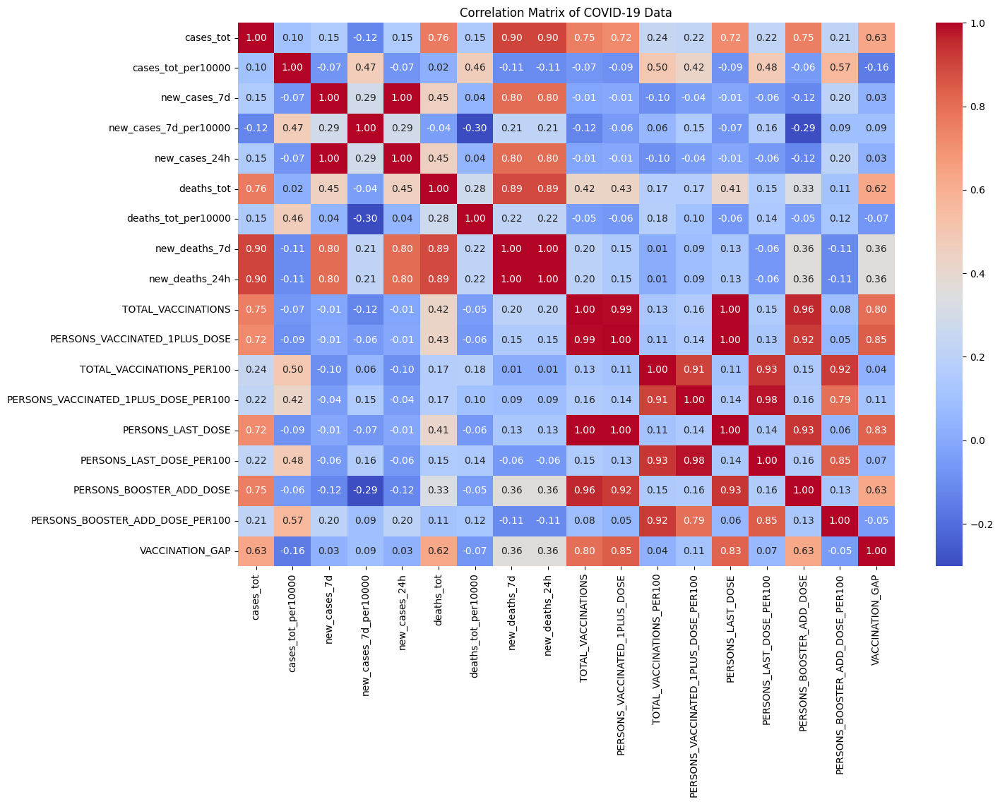

In [28]:
numeric_cols = covid_df.select_dtypes(include=np.number).drop(columns=['latitude', 'longitude'], errors='ignore')
corr_matrix = numeric_cols.corr()
plt.figure(figsize=(15,10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of COVID-19 Data')
plt.show()

##Univarate Analysis

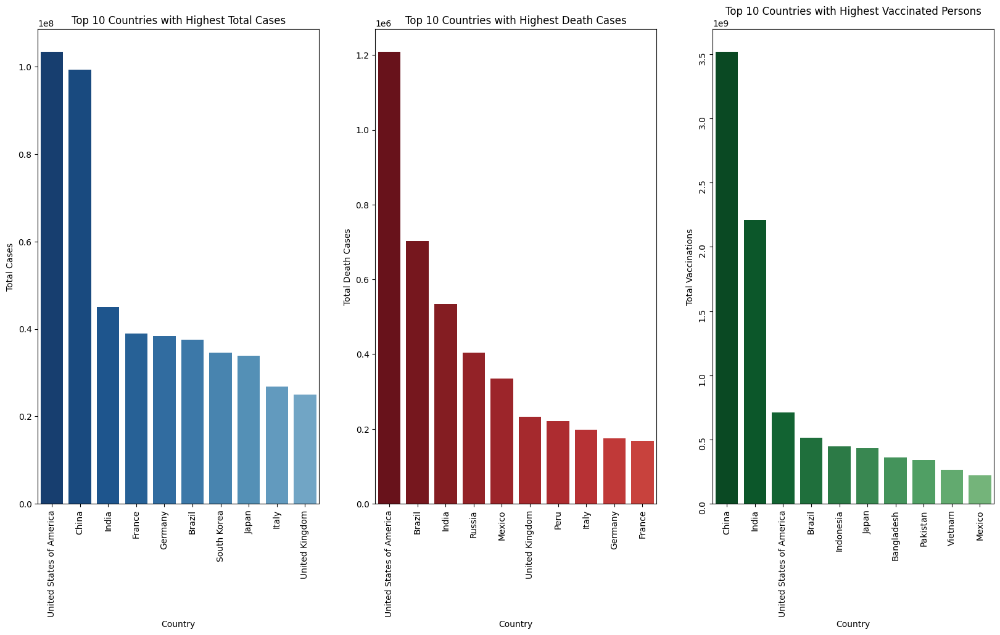

In [29]:
fig,axes=plt.subplots(1,3,figsize=(20,10))
top_10_countries = covid_df.nlargest(10, 'cases_tot')
colors = sns.color_palette("Blues_r", n_colors=20)
sns.barplot(x='country', y='cases_tot', data=top_10_countries, palette=colors,ax=axes[0])
axes[0].set_title('Top 10 Countries with Highest Total Cases')
axes[0].set_xlabel('Country')
axes[0].set_ylabel('Total Cases')
axes[0].tick_params(axis='x',rotation=90)

top_10_countries = covid_df.nlargest(10, 'deaths_tot').sort_values(by='deaths_tot', ascending=False)
colors = sns.color_palette("Reds_r", n_colors=30)
sns.barplot(x='country', y='deaths_tot', data=top_10_countries,palette=colors,ax=axes[1])
axes[1].set_title('Top 10 Countries with Highest Death Cases')
axes[1].set_xlabel('Country')
axes[1].set_ylabel('Total Death Cases')
axes[1].tick_params(axis='x',rotation=90)

top_10_countries = covid_df.nlargest(10, 'TOTAL_VACCINATIONS')
colors = sns.color_palette("Greens_r", n_colors=20)
sns.barplot(x='country', y='TOTAL_VACCINATIONS', data=top_10_countries,palette=colors,ax = axes[2])
axes[2].set_title('Top 10 Countries with Highest Vaccinated Persons')
axes[2].set_xlabel('Country')
axes[2].set_ylabel('Total Vaccinations')
axes[2].tick_params(rotation=90)
plt.show()

In [30]:
covid_df[['TOTAL_VACCINATIONS','TOTAL_VACCINATIONS_PER100']].describe()

,TOTAL_VACCINATIONS,TOTAL_VACCINATIONS_PER100
count,2.060000e+02,204.000000
mean,6.618416e+07,154.181373
std,2.990523e+08,86.255843
min,4.619000e+03,4.000000
25%,9.285050e+05,81.750000
50%,7.490693e+06,154.000000
75%,2.737500e+07,223.250000
max,3.520000e+09,470.000000


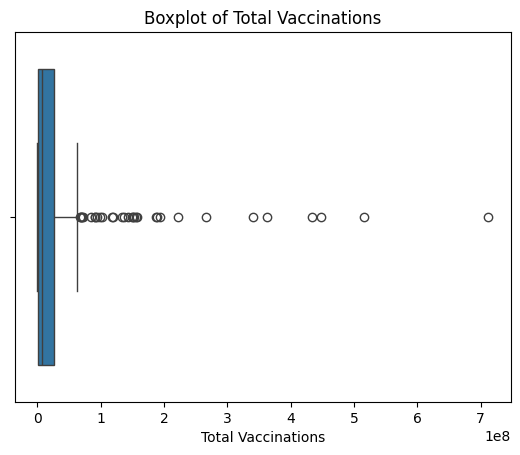

In [31]:
sns.boxplot(x='TOTAL_VACCINATIONS',data=covid_df.sort_values(by='TOTAL_VACCINATIONS',ascending=False).iloc[2:,:])
plt.title('Boxplot of Total Vaccinations')
plt.xlabel('Total Vaccinations')
plt.show()

In [32]:
covid_df['TOTAL_VACCINATIONS_PER100'].describe()

,TOTAL_VACCINATIONS_PER100
count,204.000000
mean,154.181373
std,86.255843
min,4.000000
25%,81.750000
50%,154.000000
75%,223.250000
max,470.000000


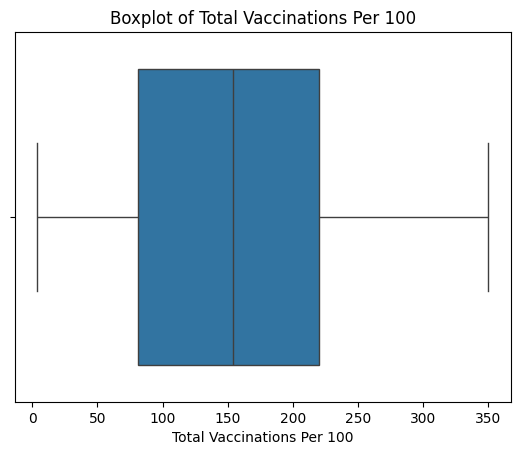

In [33]:
sns.boxplot(x='TOTAL_VACCINATIONS_PER100',data=covid_df.sort_values(by='TOTAL_VACCINATIONS_PER100',ascending=False).iloc[2:,:])
plt.title('Boxplot of Total Vaccinations Per 100')
plt.xlabel('Total Vaccinations Per 100')
plt.show()

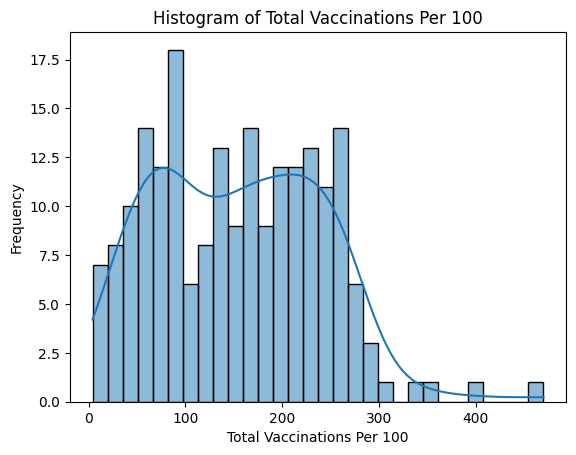

In [34]:
sns.histplot(x='TOTAL_VACCINATIONS_PER100',kde=True,bins=30,data=covid_df)
plt.title('Histogram of Total Vaccinations Per 100')
plt.xlabel('Total Vaccinations Per 100')
plt.ylabel('Frequency')
plt.show()

### Observations:


1.  The highest frequency occurs around 100 vaccinations per 100 people. This indicates that a significant number of countries (or regions) have achieved approximately this level of vaccination.
2.   The distribution appears to be right-skewed, with a long tail extending towards higher vaccination rates. This suggests that while many countries have moderate vaccination levels, a few countries have exceptionally high rates.
3. The density curve illustrates a bimodal distribution, indicating two distinct clusters of countries: one centered around 100 vaccinations per 100 people, and the other around 200 vaccinations per 100 people.

In [35]:
from scipy.stats import iqr
Q1 = np.quantile(covid_df['TOTAL_VACCINATIONS'],0.25)
Q3 = np.quantile(covid_df['TOTAL_VACCINATIONS'],0.75)
iqr = iqr(covid_df['TOTAL_VACCINATIONS'])
lower_bound = Q1 - 1.5*iqr
upper_bound = Q3 + 1.5*iqr
outliers = covid_df[(covid_df['TOTAL_VACCINATIONS']<lower_bound) | (covid_df['TOTAL_VACCINATIONS']>upper_bound)]
print(len(outliers))

0


##Bivariate analysis

###TOTAL_VACCINATIONS vs TOTAL_VACCINATIONS_PER100

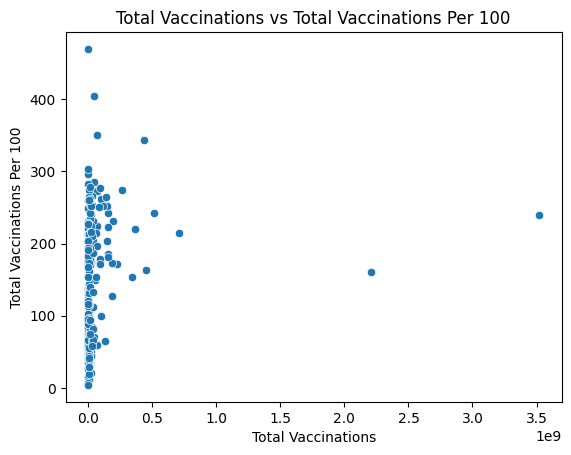

In [36]:
sns.scatterplot(x='TOTAL_VACCINATIONS',y='TOTAL_VACCINATIONS_PER100',data=covid_df)
plt.title('Total Vaccinations vs Total Vaccinations Per 100')
plt.xlabel('Total Vaccinations')
plt.ylabel('Total Vaccinations Per 100')
plt.show()

In [37]:
correlation = covid_df[['TOTAL_VACCINATIONS', 'TOTAL_VACCINATIONS_PER100']].corr()
print(correlation)

                           TOTAL_VACCINATIONS  TOTAL_VACCINATIONS_PER100
TOTAL_VACCINATIONS                   1.000000                   0.134885
TOTAL_VACCINATIONS_PER100            0.134885                   1.000000


###PERSONS_LAST_DOSE_PER100 vs PERSONS_BOOSTER_ADD_DOSE_PER100

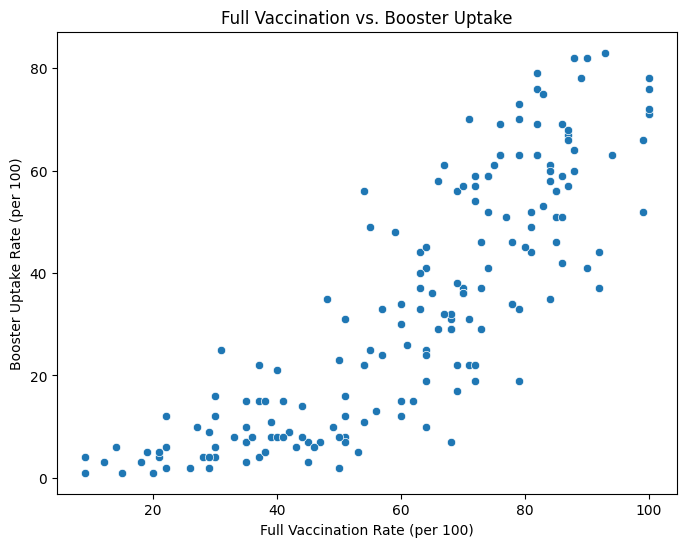

In [38]:
plt.figure(figsize=(8, 6))
sns.scatterplot(data=covid_df, x='PERSONS_LAST_DOSE_PER100', y='PERSONS_BOOSTER_ADD_DOSE_PER100')
plt.title('Full Vaccination vs. Booster Uptake')
plt.xlabel('Full Vaccination Rate (per 100)')
plt.ylabel('Booster Uptake Rate (per 100)')
plt.show()

In [39]:
covid_df['PERSONS_VACCINATED_1PLUS_DOSE'].corr(covid_df['PERSONS_LAST_DOSE'])

0.9994007672835247

There is a high correlation between the last vaccine uptake rate and booster dose uptake rate.This provides the conclusion that regions where people didn't take the last dose vaccinations also didn't take booster dose vaccination. So awareness about the "covid pandemic and vaccination intake" has to be taught.

In [40]:
covid_df.iloc[:,13:].head()

,ISO3,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_VACCINATED_1PLUS_DOSE_PER100,PERSONS_LAST_DOSE,PERSONS_LAST_DOSE_PER100,PERSONS_BOOSTER_ADD_DOSE,PERSONS_BOOSTER_ADD_DOSE_PER100,VACCINATION_GAP
0,AFG,23000000.0,19200000.0,59.0,49.0,18400000.0,47.0,2729940.0,7.0,800000.0
1,ALB,3088966.0,1349255.0,107.0,47.0,1279333.0,44.0,402371.0,14.0,69922.0
2,DZA,15300000.0,7840131.0,35.0,18.0,6481186.0,15.0,575651.0,1.0,1358945.0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AND,157072.0,57913.0,203.0,75.0,53501.0,69.0,43071.0,56.0,4412.0


In [41]:
covid_df['alive']=covid_df['cases_tot']-covid_df['deaths_tot']
covid_df.head()

,code,latitude,longitude,country,cases_tot,cases_tot_per10000,new_cases_7d,new_cases_7d_per10000,new_cases_24h,deaths_tot,...,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_VACCINATED_1PLUS_DOSE_PER100,PERSONS_LAST_DOSE,PERSONS_LAST_DOSE_PER100,PERSONS_BOOSTER_ADD_DOSE,PERSONS_BOOSTER_ADD_DOSE_PER100,VACCINATION_GAP,alive
0,AF,33.939110,67.709953,Afghanistan,235214.0,604.0,NaN,NaN,NaN,7998.0,...,23000000.0,19200000.0,59.0,49.0,18400000.0,47.0,2729940.0,7.0,800000.0,227216.0
1,AL,41.153332,20.168331,Albania,337196.0,11717.0,NaN,NaN,NaN,3608.0,...,3088966.0,1349255.0,107.0,47.0,1279333.0,44.0,402371.0,14.0,69922.0,333588.0
2,DZ,28.033886,1.659626,Algeria,272175.0,621.0,NaN,NaN,NaN,6881.0,...,15300000.0,7840131.0,35.0,18.0,6481186.0,15.0,575651.0,1.0,1358945.0,265294.0
3,AS,-14.270972,-170.132217,American Samoa,8359.0,15144.0,NaN,NaN,NaN,34.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8325.0
4,AD,42.546245,1.601554,Andorra,48015.0,62143.0,NaN,NaN,NaN,159.0,...,157072.0,57913.0,203.0,75.0,53501.0,69.0,43071.0,56.0,4412.0,47856.0


###Choropleth Analysis

In [42]:
fig = px.choropleth(
    covid_df,
    locations='ISO3',
    color='TOTAL_VACCINATIONS_PER100',
    hover_name='country',
    title='Vaccination Rate per 100 People by Country',
    color_continuous_scale='matter'
)
fig.show()


In [43]:
def create_map(column):
    base_map = folium.Map(location=[0, 0], zoom_start=3,tiles="cartodbpositron",control_scale=True,no_wrap=True,max_bounds=True,)
    bounds=[]

    for _, row in covid_df.iterrows():
        color = "blue" if column == "cases_tot" else "red" if column == "deaths_tot" else "green"
        folium.CircleMarker(
            location=[row["latitude"], row["longitude"]],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.6,
            tooltip=f"{column}: {row[column]}<br>Country: {row['country']}"
        ).add_to(base_map)


    return base_map

interact(create_map, column=["cases_tot", "deaths_tot", "TOTAL_VACCINATIONS", "TOTAL_VACCINATIONS_PER100"])


interactive(children=(Dropdown(description='column', options=('cases_tot', 'deaths_tot', 'TOTAL_VACCINATIONS',…

<function __main__.create_map(column)>